---
---
# NEURAL STYLE TRANSFER
---
---

# STEP 3 - 

In [1]:
from __future__ import print_function, division
from builtins import range, input

import tensorflow as tf

from tensorflow.keras.layers import Input, Lambda, Dense, Flatten, Conv2D, AveragePooling2D, MaxPooling2D
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt 
import numpy as np
from scipy.optimize import fmin_l_bfgs_b
from datetime import datetime

2025-11-23 17:48:22.155739: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1763920102.386153      48 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1763920102.450337      48 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

In [2]:
# From notebook 1
def VGG16_AvgPool(shape):
    #we want to account for features across the entire image
    #so we get rid of the maxpool which throws away information
    #NOT: we still lose some information but as much as maxpooling
    vgg = VGG16(input_shape=shape,
                weights='imagenet',
                include_top=False)
    #Functional API
    input_ = vgg.input
    x = input_ # start from input
    # first layer is input, therefore start from 2nd index
    for layer in vgg.layers[1:]:
        if isinstance(layer, MaxPooling2D):
            #replace it with average pooling
            x = AveragePooling2D(pool_size=(2, 2), 
                                 strides=(2, 2), 
                                 padding='valid')(x)
        else:
            x = layer(x)
    # we have a graph network now. -> .input and .output can be use
    model = Model(inputs=input_, outputs=x, name="vgg16_avgpool")
    return model

def VGG16_AvgPool_CutOff(shape, num_convs):
    # there are 13 convolutions in vgg16 total
    # we can pick any of them as the "output"
    # of our content model
    if num_convs < 1 or num_convs > 13:
        print("num_convs must be in the range [1,13]")
        return None
    #create average pooling vgg
    base_model = VGG16_AvgPool(shape)

    # count conv2d
    conv_count = 0
    cutoff_layer = None

    for layer in base_model.layers:
        if isinstance(layer, Conv2D):
            conv_count+=1
            if conv_count == num_convs:
                cutoff_layer = layer
                break
    if cutoff_layer is None:
        raise ValueError("Could not find the requested Conv2D layer.")

    cut_model = Model(inputs=base_model.input,
                      outputs=cutoff_layer.output,
                      name=f"vgg16_avgpool_cutoff_{num_convs}")    
    return cut_model

def unpreprocess(img):
    """
    VGG16 preprocess_input'in tersini yapar:
    BGR -> RGB, channel mean'leri geri ekler.
    """
    img = img.copy()
    img[..., 0] += 103.939
    img[..., 1] += 116.779
    img[..., 2] += 126.68
    img = img[..., ::-1]
    return img


def scale_img(x):
    """
    Min-max normalize [0, 1] aralığına çeker (görselleştirme için).
    """
    x = x - x.min()
    x = x / x.max()
    return x

def loss_and_grads(x_flat):
    """
    x_flat: flattened image (numpy 1D)
    return: (loss_value, grads_flat)
    """
    # 1) Change x_flat back to (1, H, W, 3)
    x_in = tf.reshape(x_flat, batch_shape)
    with tf.GradientTape() as tape:
        tape.watch(x_in)
        feats = content_model(x_in)
        #we are using all TF ops here, no KerasTensor
        loss_value = tf.reduce_mean(tf.square(feats - target))
    grads = tape.gradient(loss_value, x_in)
    # For SciPy, return numpy float and flattened grad
    loss_value = loss_value.numpy().astype('float64')
    grads = grads.numpy().flatten().astype('float64')
    return loss_value, grads

In [32]:
# From notebook 2
def gram_matrix(img):
    #input is (H,W,C) C is # of feature maps
    # we first need to convert it into (C, H*W)
    X = K.batch_flatten(K.permute_dimensions(img, (2,0,1)))

    #Now calculate the gram matrix
    # gram = X*X^T / N
    #the constant is not important since we'll be weighting these
    G = K.dot(X, K.transpose(X)) / img.get_shape().num_elements()
    return G

def style_loss(y, t):
    return K.mean(K.square(gram_matrix(y) - gram_matrix(t)))

#lets generalize this and put into a function
def minimize(fn, batch_shape, epochs, silent=False):
    """
    fn: x_flat -> (loss, grads_flat)
    batch_shape: (1, H, W, 3)
    epochs: dış L-BFGS iterasyon sayısı
    """
    t0 = datetime.now()
    losses = []

    # random init
    x_vec = np.random.randn(np.prod(batch_shape)).astype("float64")

    for i in range(epochs):
        x_vec, l, _ = fmin_l_bfgs_b(
            func=fn,
            x0=x_vec,
            maxfun=20
        )
        x_vec = np.clip(x_vec, -127, 127)
        if not silent:
            print(f"iter={i}, loss={l}")
        losses.append(l)

    print("Duration:", datetime.now() - t0)
    if not silent:
        plt.plot(losses)
        plt.title("Style loss during optimization")
        plt.xlabel("Iteration")
        plt.ylabel("Loss")
        plt.show()

    newimg = x_vec.reshape(batch_shape)
    final_img = unpreprocess(newimg)
    return final_img[0]

In [4]:
def load_img_and_preprocess(path, shape=None):
    img = image.load_img(path, target_size=shape)
    #convert img to array and preprocess for vgg
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis = 0)
    x = preprocess_input(x)
    return x

iter=0, loss=93341.3984375
iter=1, loss=16130.8935546875
iter=2, loss=10692.142578125
iter=3, loss=8278.8671875
iter=4, loss=6941.3330078125
iter=5, loss=6026.306640625
iter=6, loss=5416.2265625
iter=7, loss=5048.95703125
iter=8, loss=4755.88427734375
iter=9, loss=4523.6259765625
Duration: 0:00:34.772933


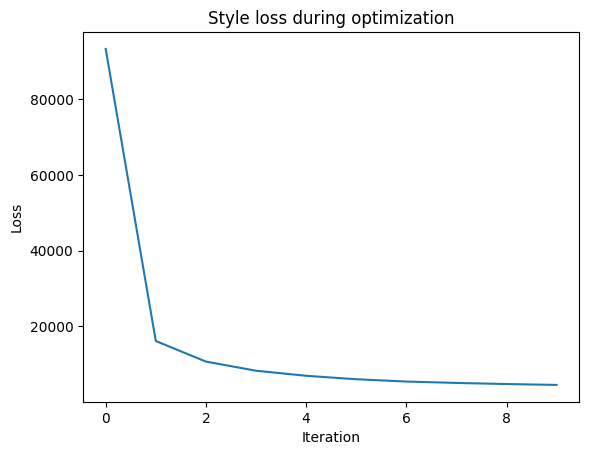

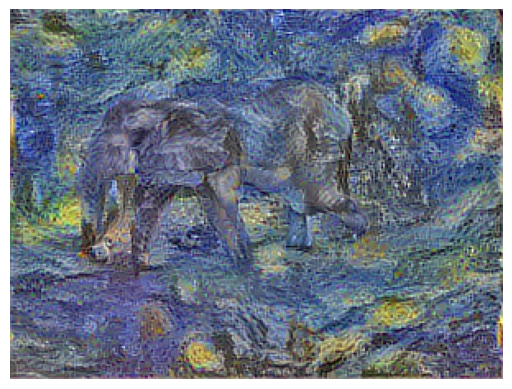

In [17]:
# 1) Content ve style img'leri yükle
content_img = load_img_and_preprocess("/kaggle/input/dataset/Data/elephant.jpg")
h, w = content_img.shape[1:3]
style_img = load_img_and_preprocess("/kaggle/input/dataset/Data/starrynight.jpg", (h, w))

# Bu script boyunca kullanacağımız şekiller
batch_shape = content_img.shape   # (1, H, W, 3)
shape = content_img.shape[1:]     # (H, W, 3)

# 2) Tek bir VGG (AvgPool'lu) modeli
vgg = VGG16_AvgPool(shape)

# 3) CONTENT MODEL
# Örnek: block4_conv2'yi content katmanı olarak kullan
content_layer = vgg.layers[13].output  # istersen: vgg.get_layer("block4_conv2").output
content_model = Model(vgg.input, content_layer)

# Content target (sabit)
content_target = content_model(content_img)     # tf.Tensor
content_target = tf.stop_gradient(content_target)

# 4) STYLE MODEL
# Her block'un ilk conv katmanını style için kullan (block1_conv1 ... block5_conv1)
symbolic_conv_outputs = [layer.output for layer in vgg.layers if layer.name.endswith("conv1")]
style_model = Model(vgg.input, symbolic_conv_outputs)

# Style target'lar (sabit)
style_targets = style_model(style_img)          # liste: [ (1, H1, W1, C1), ... ]
style_targets = [tf.stop_gradient(t) for t in style_targets]

# Ağırlıklar
style_weights = [1., 2., 3., 4., 5.]   # 5 tane conv1 katmanı var
content_weight = 1.0
style_weight_global = 1.0


# 5) Toplam loss + gradient fonksiyonu (yalnızca GradientTape!)
def total_loss_and_grads(x_flat):
    # x_flat: (H*W*3,) vektör -> (1, H, W, 3)
    x_in = tf.reshape(x_flat, batch_shape)

    with tf.GradientTape() as tape:
        tape.watch(x_in)

        # --- CONTENT LOSS ---
        content_features = content_model(x_in)  # (1, Hc, Wc, Cc)
        content_loss = tf.reduce_mean(tf.square(content_features - content_target))

        # --- STYLE LOSS ---
        style_outputs = style_model(x_in)       # liste: [ (1, Hs, Ws, Cs), ... ]
        style_loss_val = 0.0
        for w, out, target in zip(style_weights, style_outputs, style_targets):
            y = out[0]      # (Hs, Ws, Cs)
            t = target[0]   # (Hs, Ws, Cs)
            G_y = gram_matrix(y)
            G_t = gram_matrix(t)
            style_loss_val += w * tf.reduce_mean(tf.square(G_y - G_t))

        # Toplam loss
        loss = content_weight * content_loss + style_weight_global * style_loss_val

    grads = tape.gradient(loss, x_in)

    loss_value = loss.numpy().astype("float64")
    grads_value = grads.numpy().flatten().astype("float64")
    return loss_value, grads_value


# 6) L-BFGS ile optimize et
final_img = minimize(
    total_loss_and_grads,
    batch_shape=batch_shape,
    epochs=10
)

plt.imshow(scale_img(final_img))
plt.axis("off")
plt.show()


In [18]:
styles = []
path1 = "/kaggle/input/dataset/Data/flowercarrier.jpg"
path2 = "/kaggle/input/dataset/Data/lesdemoisellesdavignon.jpg"
path3 = "/kaggle/input/dataset/Data/monalisa.jpg"
path4 = "/kaggle/input/dataset/Data/starrynight.jpg"
styles.append(path1)
styles.append(path2)
styles.append(path3)
styles.append(path4)

In [27]:
def neural_style_transfer(content_path, style_path, conv2D_layer_no=13,
                          epochs=10, silent=False):
    # Her çağrıda grafiği temizle (özellikle birden fazla stil deneyeceksen iyi olur)
    tf.keras.backend.clear_session()

    # 1) Content ve style img'leri yükle
    content_img = load_img_and_preprocess(content_path)
    h, w = content_img.shape[1:3]
    style_img = load_img_and_preprocess(style_path, (h, w))

    batch_shape = content_img.shape   # (1, H, W, 3)
    shape = content_img.shape[1:]     # (H, W, 3)

    # 2) Tek bir VGG (AvgPool'lu) modeli
    vgg = VGG16_AvgPool(shape)

    # 3) CONTENT MODEL
    content_layer = vgg.layers[conv2D_layer_no].output
    content_model = Model(vgg.input, content_layer)

    content_target = content_model(content_img)
    content_target = tf.stop_gradient(content_target)

    # 4) STYLE MODEL
    symbolic_conv_outputs = [layer.output for layer in vgg.layers
                             if layer.name.endswith("conv1")]
    style_model = Model(vgg.input, symbolic_conv_outputs)

    style_targets = style_model(style_img)
    style_targets = [tf.stop_gradient(t) for t in style_targets]

    style_weights = [1., 2., 3., 4., 5.]
    content_weight = 1.0
    style_weight_global = 1.0

    # 5) Toplam loss + gradient fonksiyonu
    def total_loss_and_grads(x_flat):
        x_in = tf.reshape(x_flat, batch_shape)

        with tf.GradientTape() as tape:
            tape.watch(x_in)

            # CONTENT LOSS
            content_features = content_model(x_in)
            content_loss = tf.reduce_mean(
                tf.square(content_features - content_target)
            )

            # STYLE LOSS
            style_outputs = style_model(x_in)
            style_loss_val = 0.0
            for w, out, target in zip(style_weights, style_outputs, style_targets):
                y = out[0]    # (Hs, Ws, Cs)
                t = target[0]
                G_y = gram_matrix(y)
                G_t = gram_matrix(t)
                style_loss_val += w * tf.reduce_mean(tf.square(G_y - G_t))

            loss = content_weight * content_loss + style_weight_global * style_loss_val

        grads = tape.gradient(loss, x_in)

        loss_value = loss.numpy().astype("float64")
        grads_value = grads.numpy().flatten().astype("float64")
        return loss_value, grads_value

    # 6) L-BFGS ile optimize et
    final_img = minimize(
        total_loss_and_grads,
        batch_shape=batch_shape,
        epochs=epochs,
        silent=silent
    )   # minimize zaten unpreprocess edip (H, W, 3) döndürüyor

    # --- Görselleştirme kısmı ---

    # Content ve style tensörlerini görselleştirilebilir formata çevir
    content_vis = unpreprocess(content_img.copy())[0]   # (H, W, 3)
    style_vis = unpreprocess(style_img.copy())[0]       # (H, W, 3)

    fig, axes = plt.subplots(1, 3, figsize=(20, 8))
    fig.suptitle(f"conv2D_layer_no: {conv2D_layer_no}", fontsize=16)

    # 1) Content image
    axes[0].imshow(scale_img(content_vis))
    axes[0].set_title("Content image")
    axes[0].axis("off")

    # 2) Style image
    axes[1].imshow(scale_img(style_vis))
    axes[1].set_title("Style image")
    axes[1].axis("off")

    # 3) Neural Style Transfer sonucu
    axes[2].imshow(scale_img(final_img))
    axes[2].set_title("Neural Style Transfer")
    axes[2].axis("off")

    plt.tight_layout()
    plt.show()

iter=0, loss=83721.6484375
iter=1, loss=15850.693359375
iter=2, loss=10333.39453125
iter=3, loss=8142.90380859375
iter=4, loss=6874.0146484375
iter=5, loss=6043.568359375
iter=6, loss=5434.07421875
iter=7, loss=5027.50537109375
iter=8, loss=4746.68017578125
iter=9, loss=4538.763671875
Duration: 0:00:35.159699


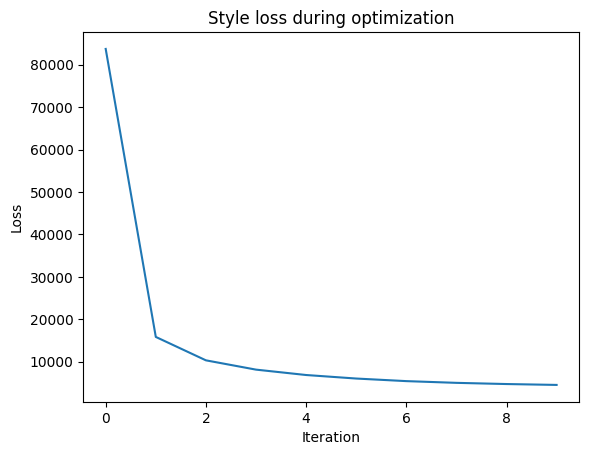

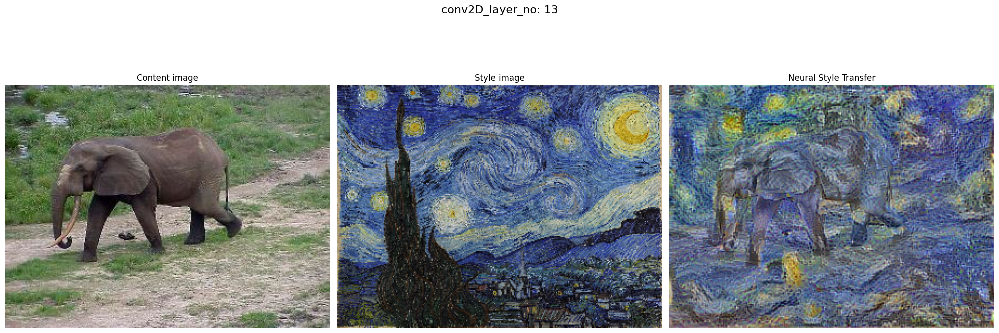

In [28]:
neural_style_transfer(content_path="/kaggle/input/dataset/Data/elephant.jpg", 
                      style_path=styles[3], 
                      conv2D_layer_no=13,
                      epochs=10, 
                      silent=False)

Style: /kaggle/input/dataset/Data/flowercarrier.jpg
For conv2D layer 13:
Duration: 0:00:34.962249


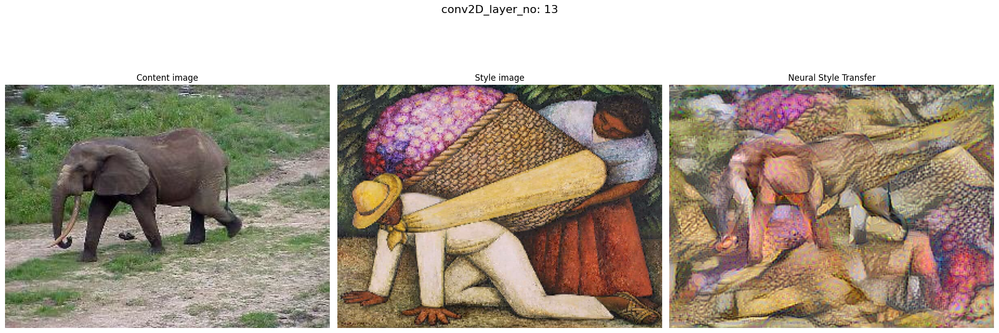

For conv2D layer 7:
Duration: 0:00:31.322471


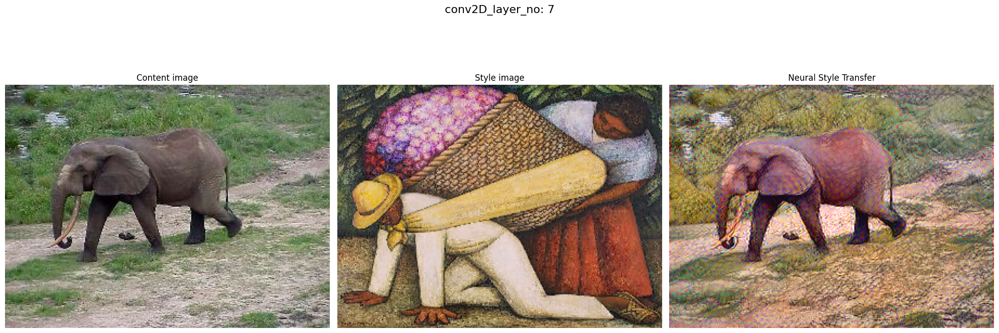

For conv2D layer 5:
Duration: 0:00:30.142185


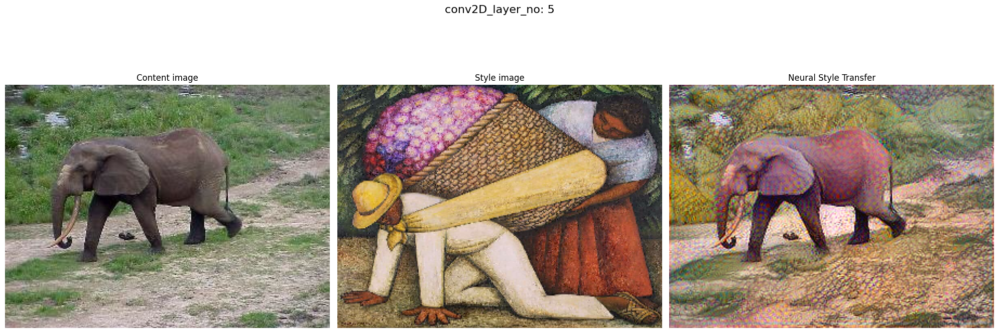

For conv2D layer 1:
Duration: 0:00:27.979169


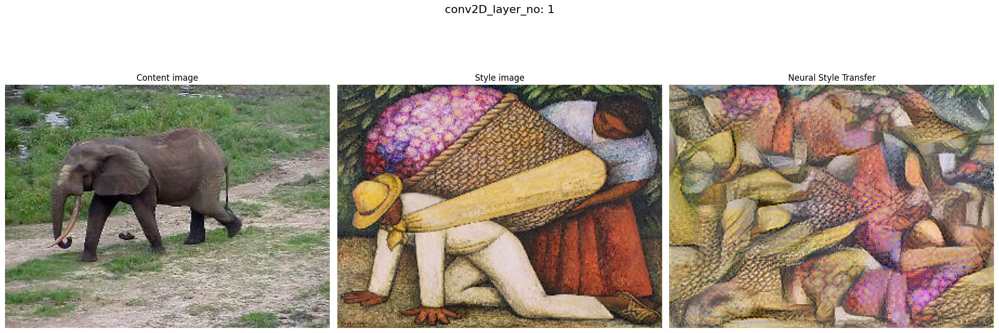

Style: /kaggle/input/dataset/Data/lesdemoisellesdavignon.jpg
For conv2D layer 13:
Duration: 0:00:34.732365


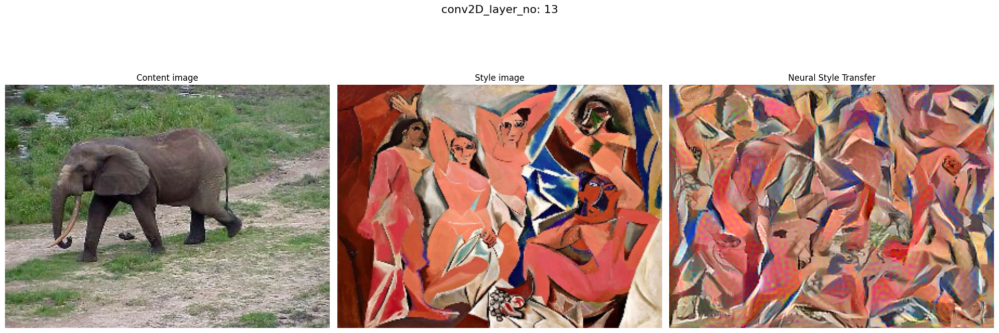

For conv2D layer 7:
Duration: 0:00:30.885043


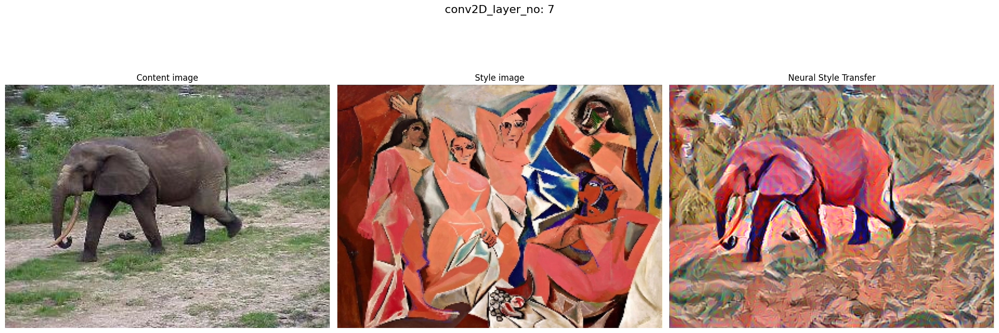

For conv2D layer 5:
Duration: 0:00:29.293748


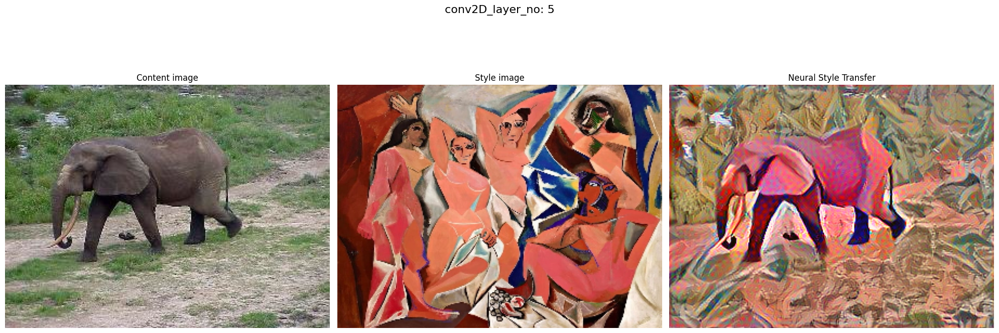

For conv2D layer 1:
Duration: 0:00:28.004319


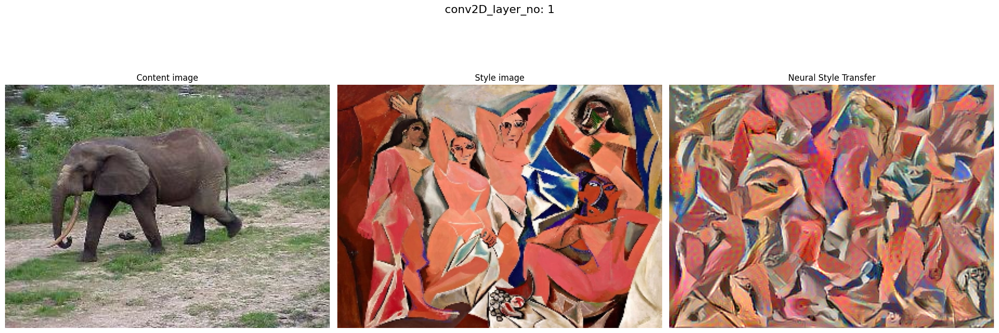

Style: /kaggle/input/dataset/Data/monalisa.jpg
For conv2D layer 13:
Duration: 0:00:34.869398


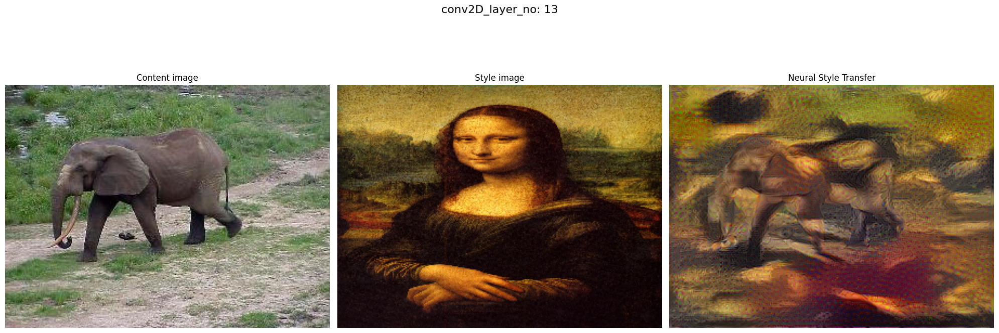

For conv2D layer 7:
Duration: 0:00:30.923132


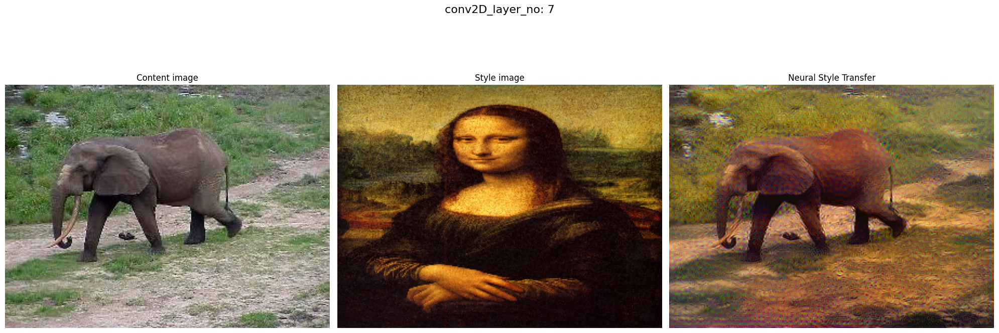

For conv2D layer 5:
Duration: 0:00:29.555430


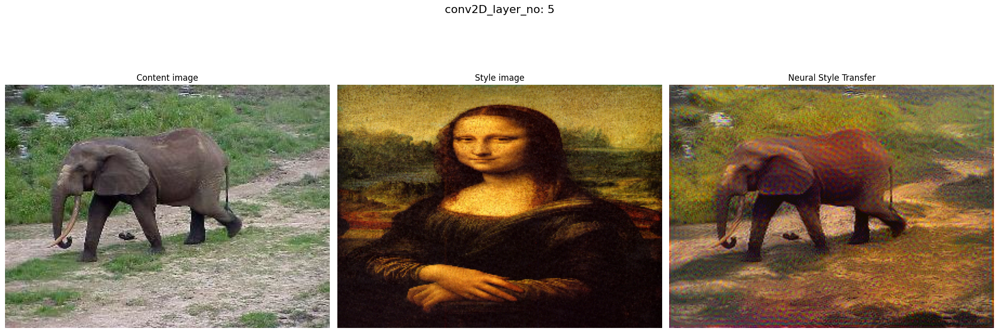

For conv2D layer 1:
Duration: 0:00:27.974820


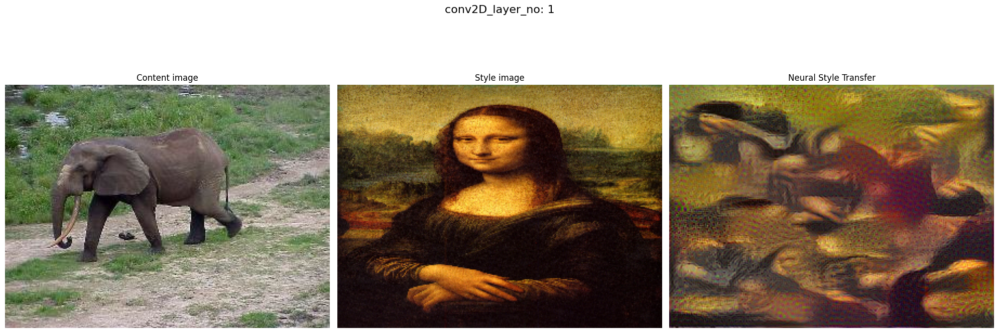

Style: /kaggle/input/dataset/Data/starrynight.jpg
For conv2D layer 13:
Duration: 0:00:34.845966


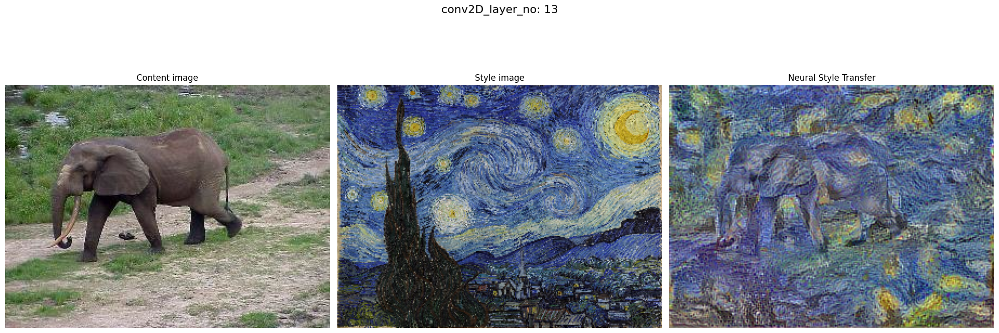

For conv2D layer 7:
Duration: 0:00:30.918172


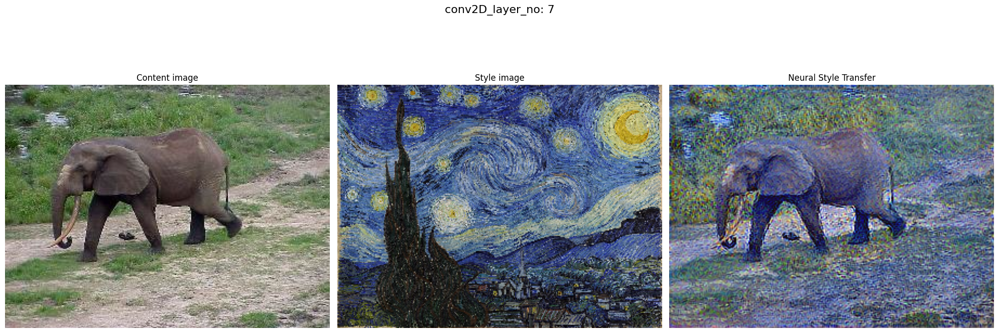

For conv2D layer 5:
Duration: 0:00:29.706748


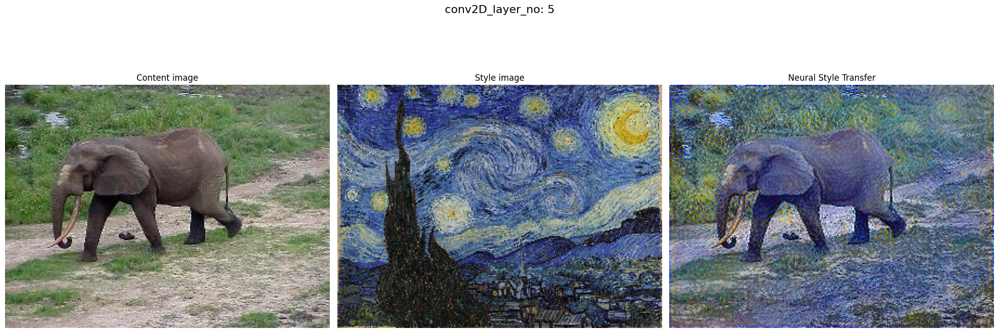

For conv2D layer 1:
Duration: 0:00:28.027447


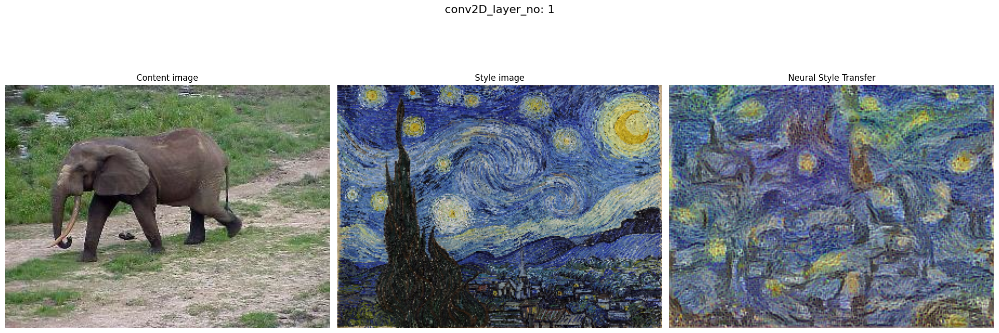

In [34]:
for style in styles:
    print(f"Style: {style}")
    print("For conv2D layer 13:")
    neural_style_transfer(content_path="/kaggle/input/dataset/Data/elephant.jpg", 
                          style_path=style, 
                          conv2D_layer_no=13,
                          epochs=10, 
                          silent=True)
    print("For conv2D layer 7:")
    neural_style_transfer(content_path="/kaggle/input/dataset/Data/elephant.jpg", 
                          style_path=style, 
                          conv2D_layer_no=7,
                          epochs=10, 
                          silent=True)
    print("For conv2D layer 5:")
    neural_style_transfer(content_path="/kaggle/input/dataset/Data/elephant.jpg", 
                          style_path=style, 
                          conv2D_layer_no=5,
                          epochs=10, 
                          silent=True)
    print("For conv2D layer 1:")
    neural_style_transfer(content_path="/kaggle/input/dataset/Data/elephant.jpg", 
                          style_path=style, 
                          conv2D_layer_no=1,
                          epochs=10, 
                          silent=True)